In [1]:
import json
import os
import requests
import pandas as pd
import numpy as np

In [2]:
with open("./scriptures-json/flat-json/book-of-mormon-flat.json", 'r') as file:
    bom = json.load(file)
with open("./scriptures-json/flat-json/doctrine-and-covenants-flat.json", 'r') as file:
    dc = json.load(file)
with open("./scriptures-json/flat-json/old-testament-flat.json", 'r') as file:
    ot = json.load(file)
with open("./scriptures-json/flat-json/new-testament-flat.json", 'r') as file:
    nt = json.load(file)
with open("./scriptures-json/flat-json/pearl-of-great-price-flat.json", 'r') as file:
    pogp = json.load(file)

In [3]:
bom = bom['verses']
dc = dc['verses']
ot = ot['verses']
nt = nt['verses']
pogp = pogp['verses']

bom = pd.DataFrame(bom)
dc = pd.DataFrame(dc)
ot = pd.DataFrame(ot)
nt = pd.DataFrame(nt)
pogp = pd.DataFrame(pogp)

In [8]:
model_id = "sentence-transformers/all-MiniLM-L6-v2"
api_url = f"https://api-inference.huggingface.co/pipeline/feature-extraction/{model_id}"
headers = {"Authorization": f"Bearer {hf_token}"}

In [9]:
def query(texts):
    response = requests.post(api_url, headers=headers, json={"inputs": texts, "options":{"wait_for_model":True}})
    return response.json()


In [10]:
bom['embedding'] = query(bom['text'].tolist())
dc['embedding'] = query(dc['text'].tolist())
pogp['embedding'] = query(pogp['text'].tolist())

In [11]:
# Split the DataFrame into four equal parts
split_parts = np.array_split(ot['text'], 4)

# Access each split part individually
part1 = split_parts[0]
part2 = split_parts[1]
part3 = split_parts[2]
part4 = split_parts[3]

In [12]:
ot1 = query(part1.tolist())
ot2 = query(part2.tolist())
ot3 = query(part3.tolist())
ot4 = query(part4.tolist())

In [13]:
# Split the DataFrame into four equal parts
split_parts = np.array_split(nt['text'], 4)

# Access each split part individually
nt1 = query(split_parts[0].tolist())
nt2 = query(split_parts[1].tolist())
nt3 = query(split_parts[2].tolist())
nt4 = query(split_parts[3].tolist())

In [14]:
otembedding = ot1 + ot2 + ot3 + ot4
ntembedding = nt1 + nt2 + nt3 + nt4
ot['embedding'] = otembedding
nt['embedding'] = ntembedding

In [15]:
data = pd.concat([ot, nt, bom, dc, pogp], ignore_index=True)

In [16]:
data.to_csv('embeddings.csv', index=False)

In [32]:
from sklearn.metrics.pairwise import cosine_similarity

# # Assuming you have a DataFrame called 'df' with columns 'reference', 'text', and 'embedding'
# df = data

# # Calculate cosine similarity matrix
# pogp_embedding_matrix = np.array(pogp['embedding'].tolist())
# bom_embedding_matrix = np.array(bom['embedding'].tolist())
# ot_embedding_matrix = np.array(ot['embedding'].tolist())
embedding_matrix = np.array(data['embedding'].tolist())
similarity_matrix = cosine_similarity(embedding_matrix, embedding_matrix)

# Find similar texts based on a reference index
# reference_index = 0  # Index of the reference text
# similar_texts = similarity_matrix[reference_index].argsort()[::-1][1:]

# # Retrieve the similar texts' reference and text
# similar_texts_references = df.loc[similar_texts, 'reference'].tolist()
# similar_texts_texts = df.loc[similar_texts, 'text'].tolist()

# Print the similar texts' references and texts
# for ref, text in zip(similar_texts_references, similar_texts_texts):
#     print('Reference:', ref)
#     print('Text:', text)
#     print('---')


In [39]:
from itertools import combinations

df = data

# Find pairs of similar texts
similar_text_pairs = []
similar_reference_pairs = []
similarity_score_list = []
threshold = 0.75  # Adjust the similarity threshold as desired

# Iterate through all combinations of text pairs
for i, j in combinations(range(len(df)), 2):
    similarity_score = similarity_matrix[i, j]

    if similarity_score > threshold:
        text_pair = (df.loc[i, 'text'], df.loc[j, 'text'])
        reference_pair = (df.loc[i, 'reference'], df.loc[j, 'reference'])
        similar_text_pairs.append(text_pair)
        similar_reference_pairs.append(reference_pair)
        similarity_score_list.append(similarity_score)

In [128]:
print(len(similar_text_pairs))
print(len(similar_reference_pairs))
print(len(similarity_score_list))

27601
27601
27601


In [127]:
print(similar_text_pairs[0], similar_reference_pairs[0], similarity_score_list[0])

('And the earth was without form, and void; and darkness was upon the face of the deep. And the Spirit of God moved upon the face of the waters.', 'And the earth was without form, and void; and I caused darkness to come up upon the face of the deep; and my Spirit moved upon the face of the water; for I am God.') ('Genesis 1:2', 'Moses 2:2') 0.9280895124388324


In [123]:
standard_works = {
    "1 Nephi",
    "2 Nephi",
    "Jacob",
    "Enos",
    "Jarom",
    "Omni",
    "Words of Mormon",
    "Mosiah",
    "Alma",
    "Helaman",
    "3 Nephi",
    "4 Nephi",
    "Mormon",
    "Ether",
    "Moroni",
    "Genesis",
    "Exodus",
    "Leviticus",
    "Numbers",
    "Deuteronomy",
    "Joshua",
    "Judges",
    "Ruth",
    "1 Samuel",
    "2 Samuel",
    "1 Kings",
    "2 Kings",
    "1 Chronicles",
    "2 Chronicles",
    "Ezra",
    "Nehemiah",
    "Esther",
    "Job",
    "Psalms",
    "Proverbs",
    "Ecclesiastes",
    "Song of Solomon",
    "Isaiah",
    "Jeremiah",
    "Lamentations",
    "Ezekiel",
    "Daniel",
    "Hosea",
    "Joel",
    "Amos",
    "Obadiah",
    "Jonah",
    "Micah",
    "Nahum",
    "Habakkuk",
    "Zephaniah",
    "Haggai",
    "Zechariah",
    "Malachi"
    "Matthew",
    "Mark",
    "Luke",
    "John",
    "Acts",
    "Romans",
    "1 Corinthians",
    "2 Corinthians",
    "Galatians",
    "Ephesians",
    "Philippians",
    "Colossians",
    "1 Thessalonians",
    "2 Thessalonians",
    "1 Timothy",
    "2 Timothy",
    "Titus",
    "Philemon",
    "Hebrews",
    "James",
    "1 Peter",
    "2 Peter",
    "1 John",
    "2 John",
    "3 John",
    "Jude",
    "Revelation"
    "Moses",
    "Abraham",
    "Joseph Smith—Matthew",
    "Joseph Smith—History",
    "Articles of Faith"
}


In [124]:
def seperateReference(ref):
    book = ' '.join(ref.split(' ')[:-1])
    chapter = ref.split(' ')[-1].split(':')[0]
    verse = ref.split(' ')[-1].split(':')[1]
    return book, chapter, verse

In [125]:
print(seperateReference(similar_reference_pairs[0][0]))

('Genesis', '1', '2')


In [130]:
embedding_dict = {}
errors = []
for texts, references, score in zip(similar_text_pairs, similar_reference_pairs, similarity_score_list):
    text1, text2 = texts
    ref1, ref2 = references
    book1, chapter1, verse1 = seperateReference(ref1)
    book2, chapter2, verse2 = seperateReference(ref2)
    if book1 not in embedding_dict:
        embedding_dict[book1] = {}
    if book2 not in embedding_dict:
        embedding_dict[book2] = {}
    if ref1 not in embedding_dict[book1]:
        embedding_dict[book1][ref1] = []
    if ref2 not in embedding_dict[book2]:
        embedding_dict[book2][ref2] = []

    embedding_dict[book1][ref1].append((ref2, score))
    embedding_dict[book2][ref2].append((ref1, score))

print(embedding_dict['Genesis']['Genesis 1:2'])

    

[]
[('Moses 2:2', 0.9280895124388324), ('Abraham 4:2', 0.8702623678127861)]


In [131]:
with open("embedding_dict.json", "w") as json_file:
    json.dump(embedding_dict, json_file)

In [132]:
embedding_dict['Helaman']['Helaman 10:1']

[('Alma 27:14', 0.7810538229985319), ('Helaman 7:12', 0.7744505557121641)]

In [73]:
references_list = data['reference']

# Extract the book from each reference
books_list = [' '.join(reference.split(' ')[:-1]) for reference in references_list]
data['book'] = books_list
print(data['book'])

0       1 Nephi
1       1 Nephi
2       1 Nephi
3       1 Nephi
4       1 Nephi
         ...   
6599     Moroni
6600     Moroni
6601     Moroni
6602     Moroni
6603     Moroni
Name: book, Length: 6604, dtype: object


In [80]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Assuming you have a DataFrame called 'df' with columns 'embedding' and 'book'
df['book'] = pd.Categorical(df['book'])

# Get the embeddings as a matrix
embedding_matrix = np.array(df['embedding'].tolist())

# Perform clustering with K-means
num_clusters = 3  # Specify the number of clusters
kmeans = KMeans(n_clusters=num_clusters)
cluster_labels = kmeans.fit_predict(embedding_matrix)

# Perform dimensionality reduction with t-SNE
tsne = TSNE(n_components=2, random_state=42)
embedding_2d = tsne.fit_transform(embedding_matrix)

# Add the cluster labels and 'book' column to the DataFrame
df['cluster_label'] = cluster_labels


c:\Users\justi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


ValueError: invalid literal for int() with base 10: '$\\mathdefault{0}$'

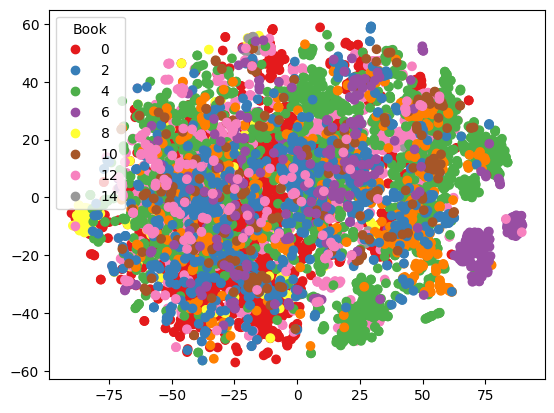

In [94]:
# Convert 'book' column to 'category' dtype
#df['book'] = df['book'].astype('category')

# Create a dictionary to map category codes to labels
book_labels = dict(enumerate(df['book'].cat.categories))

# Plot the clusters colored by the 'book' column
fig, ax = plt.subplots()
scatter = ax.scatter(embedding_2d[:, 0], embedding_2d[:, 1], c=df['book'].cat.codes, cmap='Set1')
legend = ax.legend(*scatter.legend_elements(), title='Book')

# Update legend labels with actual text labels
legend.texts = [book_labels[int(label.get_text())] for label in legend.texts]

plt.show()

In [116]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Assuming you have a DataFrame called 'df' with columns 'embedding' and 'book'

# Convert 'book' column to 'category' dtype
df['book'] = df['book'].astype('category')

# Create a dictionary to map category codes to labels
book_labels = dict(enumerate(df['book'].cat.categories))

# Get the embeddings as a matrix
embedding_matrix = np.array(df['embedding'].tolist())

# Perform clustering with K-means
num_clusters = 6  # Specify the number of clusters
kmeans = KMeans(n_clusters=num_clusters)
cluster_labels = kmeans.fit_predict(embedding_matrix)

# Perform dimensionality reduction with t-SNE
tsne = TSNE(n_components=2, random_state=42)
embedding_2d = tsne.fit_transform(embedding_matrix)

# Add the cluster labels and 'book' column to the DataFrame
df['cluster_label'] = cluster_labels




c:\Users\justi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


c:\Users\justi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\justi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\justi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\justi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value 

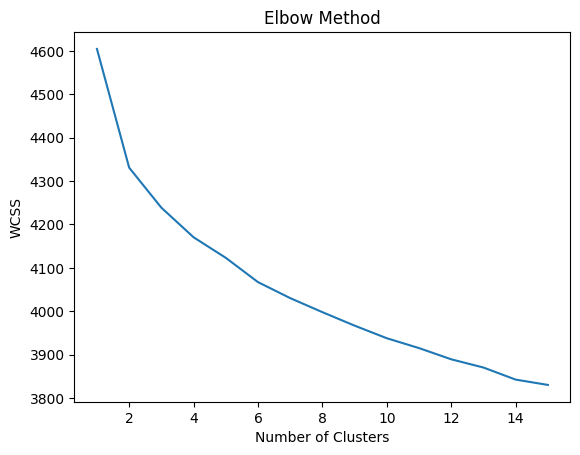

In [115]:
# Perform clustering with K-means
max_clusters = 15  # Maximum number of clusters to test
wcss = []  # List to store the within-cluster sum of squares

for num_clusters in range(1, max_clusters + 1):
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(embedding_matrix)
    wcss.append(kmeans.inertia_)

# Plot the WCSS against the number of clusters
plt.plot(range(1, max_clusters + 1), wcss)
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.title('Elbow Method')
plt.show()


In [108]:
# Create a dictionary to map category codes to labels
book_labels = dict(enumerate(df['book'].cat.categories))

# Set the desired figure size
fig, ax = plt.subplots(figsize=(20, 16), dpi=1000)  # Adjust the figsize parameter as needed
# Plot the clusters colored by the cluster labels
scatter = ax.scatter(embedding_2d[:, 0], embedding_2d[:, 1], c=df['cluster_label'], cmap='Set1', s=10)  # Switch to 'cluster_label' for coloring

# Create a legend using the cluster labels
handles, _ = scatter.legend_elements()
labels = [str(label) for label in df['cluster_label'].unique()]  # Get unique cluster labels
legend = ax.legend(handles, labels, title='Cluster')
ax.add_artist(legend)

# Add reference labels to each point
for i, reference in enumerate(df['reference']):
    ax.text(embedding_2d[i, 0], embedding_2d[i, 1], reference, fontsize=1, ha='center', va='center')

plt.show()


In [121]:
# Assuming you have a DataFrame called 'df' with columns 'book' and 'cluster_label'

# Group the DataFrame by 'book' and 'cluster_label' and calculate the count
grouped = df.groupby(['book', 'cluster_label']).size().reset_index(name='count')

# Calculate the total count of each book
book_counts = grouped.groupby('book')['count'].sum()

# Calculate the percentage of each book in each cluster
grouped['percentage'] = grouped['count'] / grouped['book'].map(book_counts) * 100

# Print the statistics
print(grouped[0:20])

       book  cluster_label  count  percentage
0   1 Nephi              0     18    2.912621
1   1 Nephi              1    150   24.271845
2   1 Nephi              2     81   13.106796
3   1 Nephi              3    169   27.346278
4   1 Nephi              4    131   21.197411
5   1 Nephi              5     69   11.165049
6   2 Nephi              0      2    0.256739
7   2 Nephi              1     51    6.546855
8   2 Nephi              2     48    6.161746
9   2 Nephi              3    227   29.139923
10  2 Nephi              4    422   54.172015
11  2 Nephi              5     29    3.722721
12  3 Nephi              0     11    1.401274
13  3 Nephi              1    185   23.566879
14  3 Nephi              2     93   11.847134
15  3 Nephi              3    256   32.611465
16  3 Nephi              4    182   23.184713
17  3 Nephi              5     58    7.388535
18  4 Nephi              0      3    6.122449
19  4 Nephi              1     20   40.816327


In [140]:
# Assuming you have a DataFrame called 'df' with columns 'book' and 'cluster_label'
# Define the order of books
book_order = ['1 Nephi', '2 Nephi', 'Jacob', 'Enos', 'Jarom', 'Omni', 'Words of Mormon', 'Mosiah',
              'Alma', 'Helaman', '3 Nephi', '4 Nephi', 'Mormon', 'Ether', 'Moroni']

# Convert 'book' column to categorical with the specified order
df['book'] = pd.Categorical(df['book'], categories=book_order, ordered=True)

# Filter the DataFrame for cluster_label == 1
cluster_1_df = df[df['cluster_label'] == 4]
#cluster_1_df = df

# Group the filtered DataFrame by 'book' and calculate the count
grouped = cluster_1_df.groupby('book').size().reset_index(name='count')

# Calculate the total count of cluster_label == 1 for each book
total_count = grouped['count'].sum()

# Calculate the percentage of each book in cluster_label == 1
grouped['percentage'] = grouped['count'] / total_count * 100

# Print the statistics
print(grouped)


               book  count  percentage
0           1 Nephi    131    9.059474
1           2 Nephi    422   29.183956
2             Jacob     86    5.947441
3              Enos      1    0.069156
4             Jarom      2    0.138313
5              Omni      2    0.138313
6   Words of Mormon      0    0.000000
7            Mosiah    129    8.921162
8              Alma    281   19.432918
9           Helaman     90    6.224066
10          3 Nephi    182   12.586445
11          4 Nephi      0    0.000000
12           Mormon     43    2.973721
13            Ether     47    3.250346
14           Moroni     30    2.074689


In [141]:
import pandas as pd

# Assuming you have a DataFrame called 'df' with columns 'reference', 'text', 'embedding', and 'book' for each verse

# Define the order of books
book_order = ['1 Nephi', '2 Nephi', 'Jacob', 'Enos', 'Jarom', 'Omni', 'Words of Mormon', 'Mosiah',
              'Alma', 'Helaman', '3 Nephi', '4 Nephi', 'Mormon', 'Ether', 'Moroni']

# Convert 'book' column to categorical with the specified order
df['book'] = pd.Categorical(df['book'], categories=book_order, ordered=True)

# Calculate the total number of verses for each book
book_verse_counts = df.groupby('book')['reference'].count()

# Filter the DataFrame for cluster_label == 1
cluster_1_df = df[df['cluster_label'] == 4]

# Group the filtered DataFrame by 'book' and calculate the total number of verses and the count
grouped = cluster_1_df.groupby('book').agg({'reference': 'count', 'text': 'sum'}).reset_index()
grouped.rename(columns={'reference': 'count', 'text': 'total_text'}, inplace=True)

# Calculate the percentage of each book in cluster_label == 1 based on the total number of verses
grouped['percentage'] = grouped['count'] / grouped['book'].map(book_verse_counts) * 100

# Print the statistics
print(grouped[['book', 'count', 'percentage']])


               book  count  percentage
0           1 Nephi    131   21.197411
1           2 Nephi    422   54.172015
2             Jacob     86   42.364532
3              Enos      1    3.703704
4             Jarom      2   13.333333
5              Omni      2    6.666667
6   Words of Mormon      0    0.000000
7            Mosiah    129   16.433121
8              Alma    281   14.227848
9           Helaman     90   18.108652
10          3 Nephi    182   23.184713
11          4 Nephi      0    0.000000
12           Mormon     43   18.942731
13            Ether     47   10.854503
14           Moroni     30   18.404908
